In [3]:
import pandas as pd
import os
from helper import plot_sample_images, plot_sample_images_multi, rgb_splitter
from util import convert_to_yolov5
import numpy as np

In [2]:
df_train, df_test = pd.read_csv('./Train.csv'), pd.read_csv('./Test.csv')
print(f"Training Data Shape:  {df_train.shape}\nTest Data Shape:      {df_test.shape}")

Training Data Shape:  (3906, 6)
Test Data Shape:      (931, 1)


In [3]:
df_train.Image_ID.nunique()

3001

In [4]:
df_train[df_train['class'] == 'fruit_healthy'].Image_ID.unique()

array(['ID_00ZJEEK3', 'ID_05R05ZLJ', 'ID_06EXUMWA', ..., 'ID_ZZ5YBO5A',
       'ID_ZZAB1FH1', 'ID_ZZJZ2CV6'], dtype=object)

In [5]:
df_train['class'].value_counts()

fruit_healthy      1638
fruit_woodiness    1246
fruit_brownspot    1022
Name: class, dtype: int64

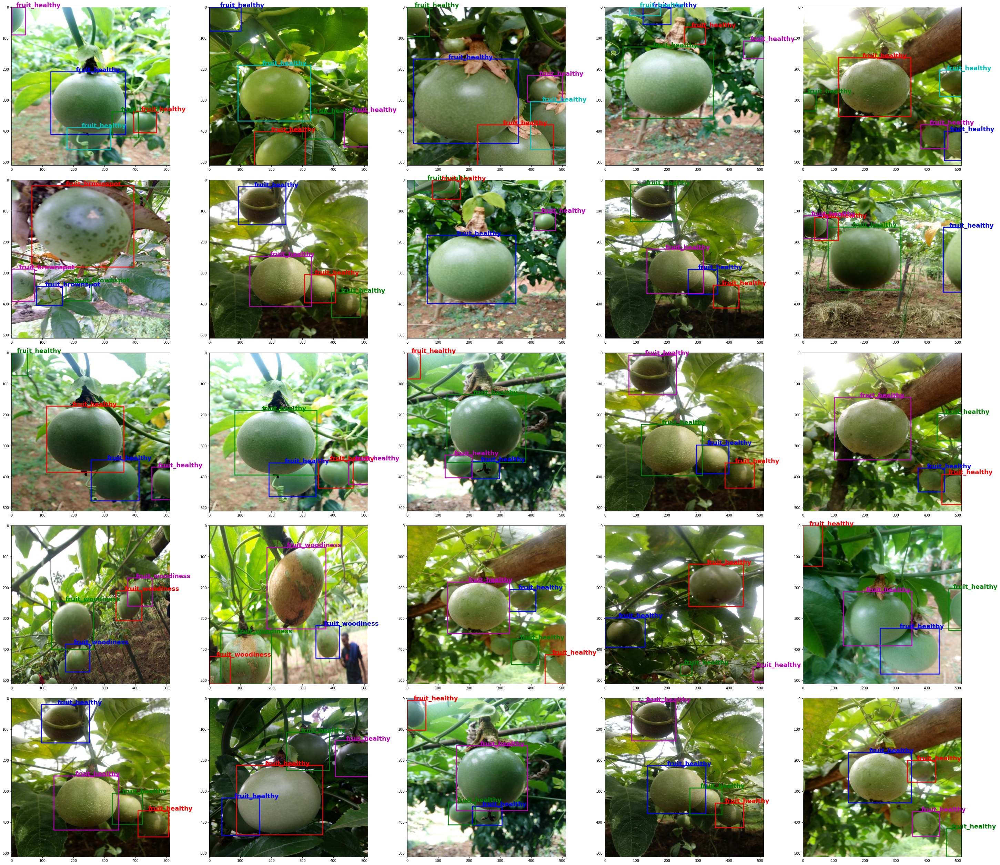

In [6]:
plot_sample_images_multi(df_train)

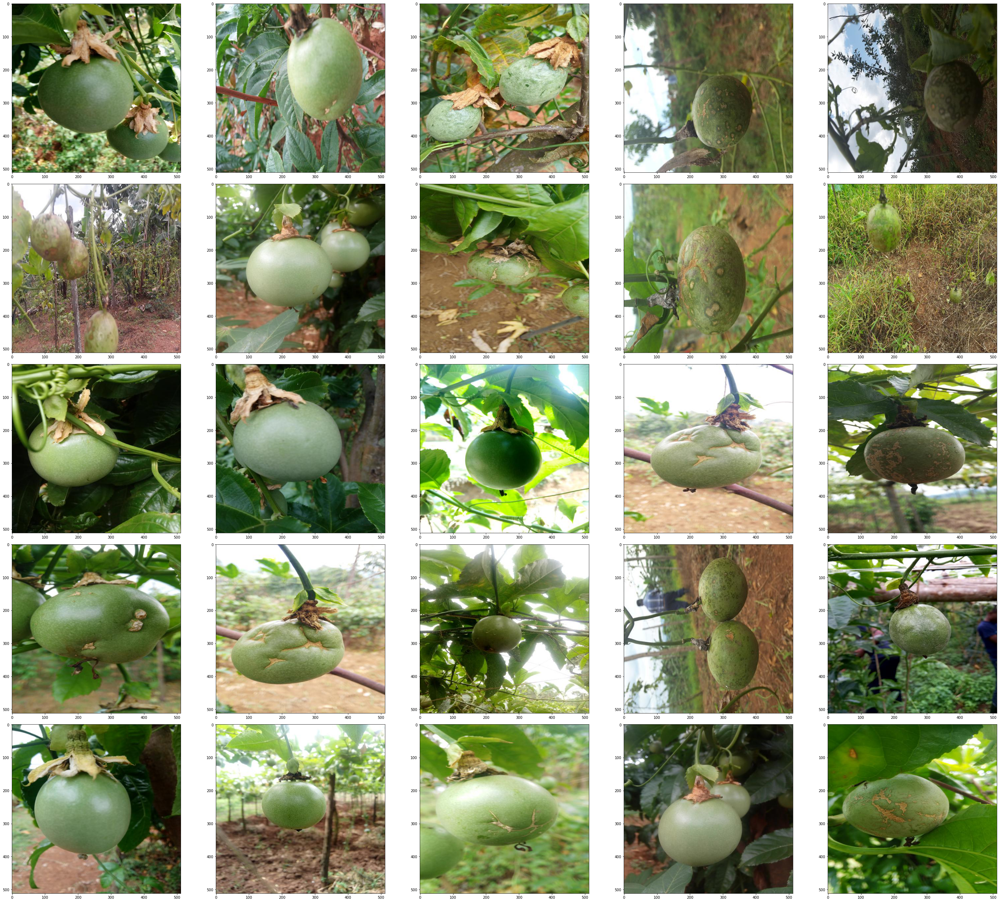

In [7]:
plot_sample_images_multi(df_test, show_label=False, is_train=False)

In [8]:
regenerate_labels = False
if regenerate_labels:
    convert_to_yolov5(df_train)

In [9]:
regenerate_train_val_split = True
if regenerate_train_val_split:
    np.random.seed(123)
    arrays = []
    for class_name in df_train['class'].unique():
        arrays.append(np.random.choice(df_train[df_train['class'] == class_name].Image_ID.unique(), 108))
    test_set_files = np.unique(np.concatenate(arrays))

    for file in test_set_files:
        print(f"Moving {file}....")
        os.rename(f"./Train_Images/{file}.jpg", f"./Val_Images/{file}.jpg")
        os.rename(f"./yolo5Input/{file}.txt", f"./Val_Labels/{file}.txt")

Moving ID_052XYWUM....
Moving ID_055U1LPM....
Moving ID_05R05ZLJ....
Moving ID_0A1VFEP3....
Moving ID_0CISYX8S....
Moving ID_0DMO6F68....
Moving ID_0GBCSTHR....
Moving ID_0HUIQ8FI....
Moving ID_0ONXVO0U....
Moving ID_0VM4L0BV....
Moving ID_0VWM4W9V....
Moving ID_1IB219OR....
Moving ID_1PVZCA10....
Moving ID_1SK27OUD....
Moving ID_1VLS0LOL....
Moving ID_1XA2LAB1....
Moving ID_21VUG5GR....
Moving ID_25EIO3CX....
Moving ID_2EJUF50U....
Moving ID_2KO4MFWQ....
Moving ID_2RQE8VAW....
Moving ID_2TW1G4B1....
Moving ID_2UQMICCQ....
Moving ID_331XG3TA....
Moving ID_354G0XRK....
Moving ID_36YBKYGR....
Moving ID_3BD1WQYF....
Moving ID_3EBD0745....
Moving ID_3EJN1FEF....
Moving ID_3EWHG1WM....
Moving ID_3MV1YD94....
Moving ID_3SZ8VYOT....
Moving ID_3THEMZOL....
Moving ID_3VJTZ7Q7....
Moving ID_41GYUV3N....
Moving ID_420AKEHR....
Moving ID_42H3WNGM....
Moving ID_45HOPU5L....
Moving ID_4FXVGH4F....
Moving ID_4I8I4O3A....
Moving ID_4J55WK8L....
Moving ID_4JQ4KA2W....
Moving ID_4JQLR0PD....
Moving ID_4

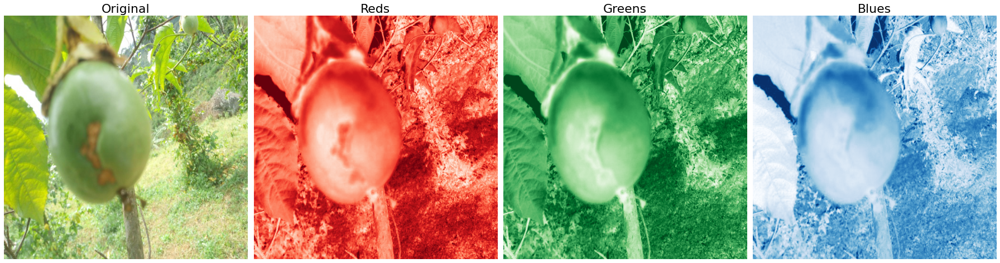

In [10]:
rgb_splitter('ID_007FAIEI')